# Object Detection API Webcam

# Setup
#### Make sure to change your directory to models/research/objection_detection before running.

In [14]:
import os
import pathlib


if "object_detection_dominoes" in pathlib.Path.cwd().parts:
  while "object_detection_dominoes" in pathlib.Path.cwd().parts:
    os.chdir('..')

### Imports

In [15]:
import cv2
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import time
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

Import the object detection module.

In [16]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

Patches:

In [17]:
# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

# Model preparation 

## Variables

##### Here we use our model which retrained based on faster_rcnn_resnet50 with the following configurations:
Total steps: 25000

Warm-up steps: 2000

Learning rate: 0.01

Warm-up learning rate: 0.0033333

Batch Size: 1

Optimizer: Momentum Optimizer (0.9)

## Loader

In [18]:
def load_model():
  model_dir = "object_detection_dominoes/output_graph/saved_model"
  model = tf.saved_model.load(str(model_dir))
  return model

## Loading label map

In [19]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'object_detection_dominoes/images/object-detection.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

For the sake of simplicity we will test on 2 images:

In [20]:
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('object_detection_dominoes/images/test')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('object_detection_dominoes/images/test/IMG_7242.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7243.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7244.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7245.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7246.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7247.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7248.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7249.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7250.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7252.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7253.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7254.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7256.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7257.jpg'),
 PosixPath('object_detection_dominoes/images/test/IMG_7259.jpg'),
 PosixPath

# Detection

Load an object detection model:

In [21]:
detection_model = load_model()

Check the model's input signature, it expects a batch of 3-color images of type uint8:

In [22]:
print(detection_model.signatures['serving_default'].inputs)

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_14:0' shape=<unknown> dtype=resource>, <

And returns several outputs:

In [23]:
detection_model.signatures['serving_default'].output_dtypes

{'detection_boxes': tf.float32,
 'raw_detection_scores': tf.float32,
 'detection_multiclass_scores': tf.float32,
 'num_detections': tf.float32,
 'detection_anchor_indices': tf.float32,
 'detection_classes': tf.float32,
 'raw_detection_boxes': tf.float32,
 'detection_scores': tf.float32}

In [24]:
detection_model.signatures['serving_default'].output_shapes

{'detection_boxes': TensorShape([1, 300, 4]),
 'raw_detection_scores': TensorShape([1, 300, 7]),
 'detection_multiclass_scores': TensorShape([1, 300, 7]),
 'num_detections': TensorShape([1]),
 'detection_anchor_indices': TensorShape([1, 300]),
 'detection_classes': TensorShape([1, 300]),
 'raw_detection_boxes': TensorShape([1, 300, 4]),
 'detection_scores': TensorShape([1, 300])}

Add a wrapper function to call the model, and cleanup the outputs:

In [25]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [26]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

## Testing
#### Run it on each test image and show the results:

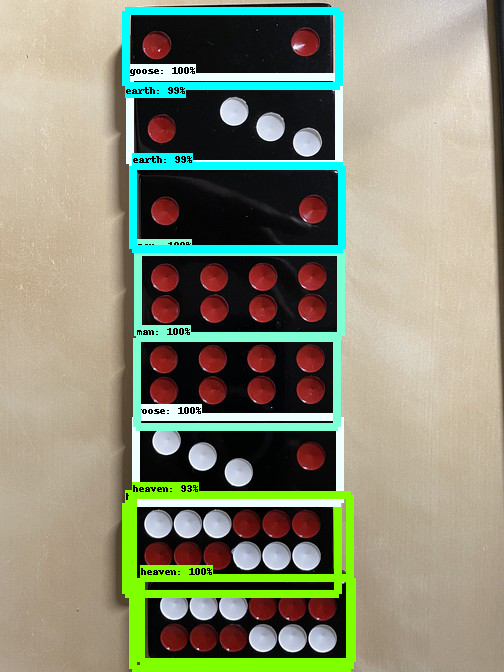

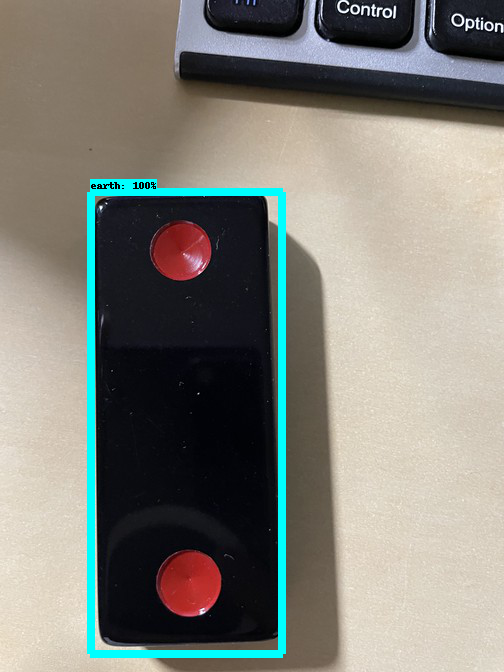

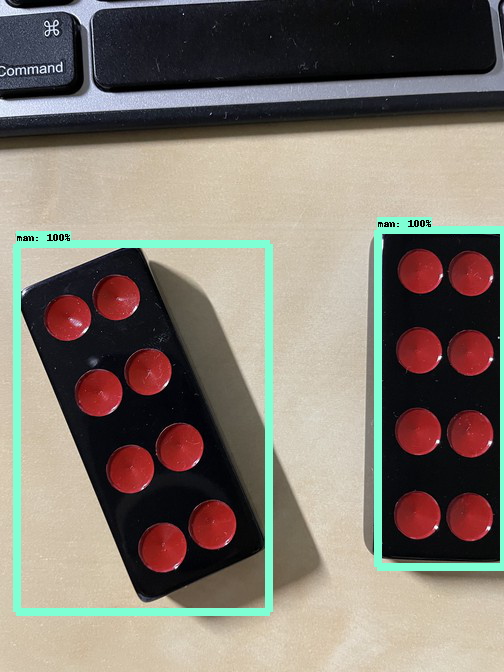

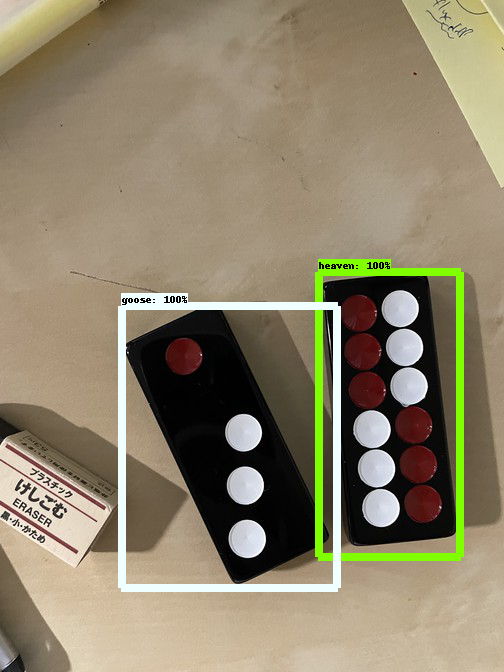

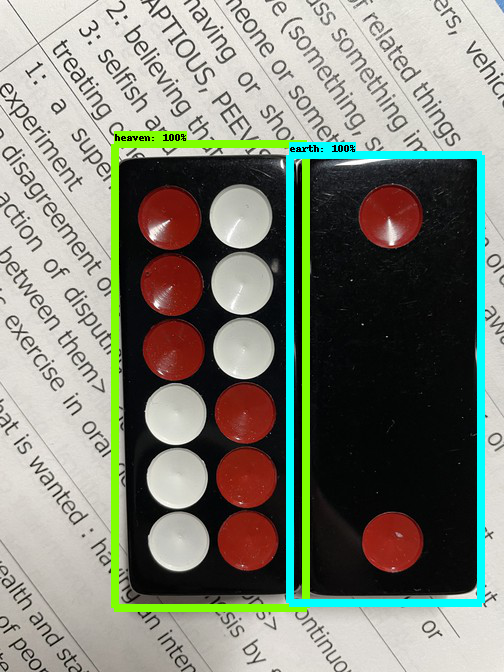

...

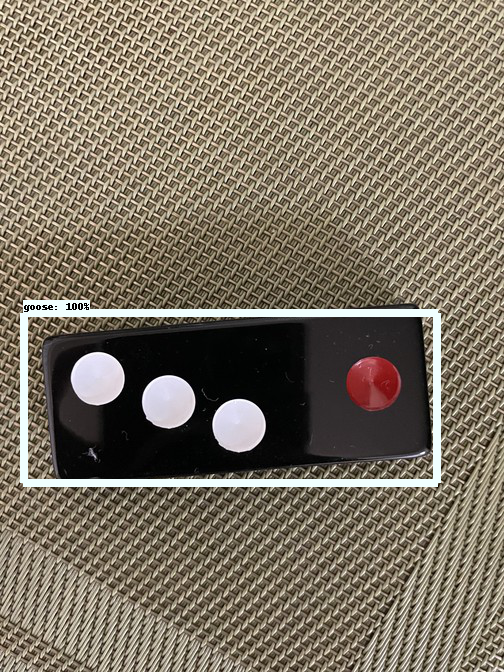

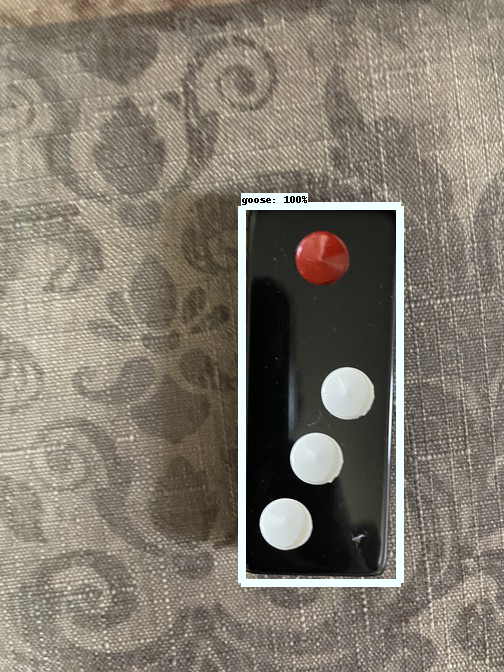

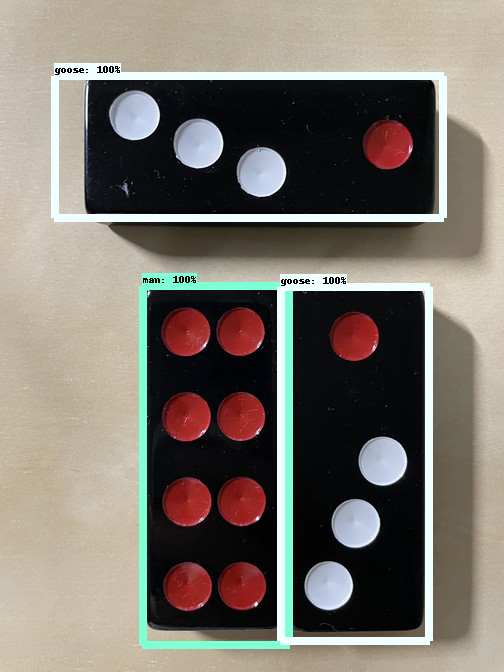

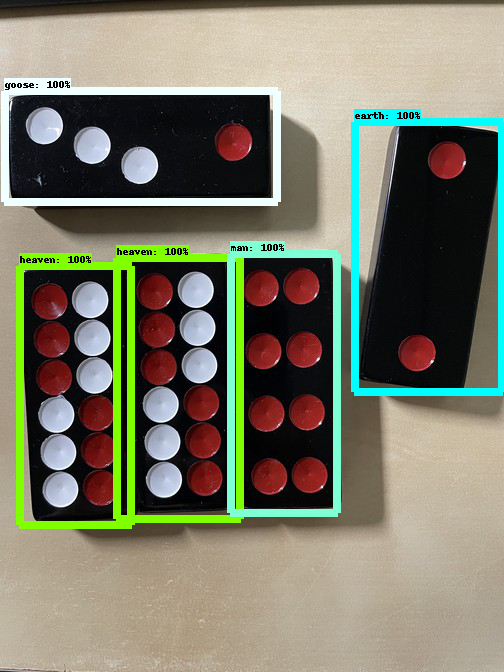

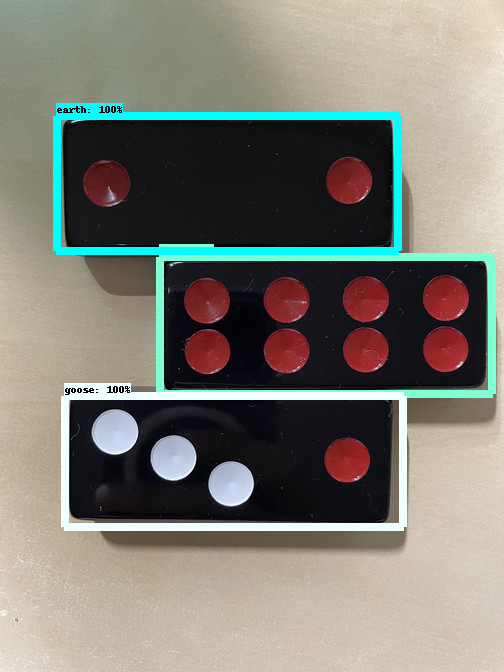

In [27]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)

## Webcam Application
#### Run our object detection algorithm in real-time for application usage

In [28]:
def show_webcam(model):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  ret, image_np = cap.read()
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  cv2.imshow('object detection', cv2.resize(image_np, (1600,900)))

In [29]:
# Initialize camera and wait for it to be ready
cap = cv2.VideoCapture(0)
time.sleep(5)

# Launch Webcam Object Detection Window
while (cap.isOpened()):
  show_webcam(detection_model)
  if cv2.waitKey(25) & 0xFF == ord('q'):
    cap.release()
    cv2.destroyAllWindows()
    break